# Day 13: Mine Cart Madness

In [1]:
import itertools
import io
import copy
from PIL import Image, ImageDraw

class Cart:
    DIR_UP = 0
    DIR_RIGHT = 1
    DIR_DOWN = 2
    DIR_LEFT = 3
    DIR_STR = ('Up', 'Right', 'Down', 'Left')
    CART_CHARS = ('^', '>', 'v', '<')
    MOVE_STRAIGHT = ((0, -1), (1, 0), (0, 1), (-1, 0))
    TURN_PATTERNS = {
        '\\': {
            DIR_RIGHT: DIR_DOWN,
            DIR_UP: DIR_LEFT,
            DIR_DOWN: DIR_RIGHT,
            DIR_LEFT: DIR_UP
        },
        '/': {
            DIR_UP: DIR_RIGHT,
            DIR_LEFT: DIR_DOWN,
            DIR_DOWN: DIR_LEFT,
            DIR_RIGHT: DIR_UP
        },
    }
    
    def __init__(self, x, y, c):
        self.x = x
        self.y = y
        self.dir = self.CART_CHARS.index(c)
        self.intersection = 0
        self.crashed = False
        
    def __str__(self):
        return "{},{},{},{}".format(self.x, self.y, self.DIR_STR[self.dir], self.intersection)

    def move_next(self):
        global tracks
        move = self.MOVE_STRAIGHT[self.dir]
        self.x += move[0]
        self.y += move[1]
    
        c = tracks[self.y][self.x]
        if c in self.TURN_PATTERNS.keys():
            self.dir = self.TURN_PATTERNS[c][self.dir]
        elif c == '+':
            self.take_intersection()
    
        return (x, y, c)
    
    def take_intersection(self):
        if self.intersection == 0:
            self.turn_left()
        elif self.intersection == 1:
            pass
        elif self.intersection == 2:
            self.turn_right()
        self.intersection = ((self.intersection + 1) % 3)
    
    def turn_left(self):
        self.dir = ((self.dir - 1) % 4)
        
    def turn_right(self):
        self.dir = ((self.dir + 1) % 4)
        
    def get_position(self):
        return (self.x, self.y)
    
with open('inputs/13.txt') as f:
    tracks = [list(l.strip('\r\n')) for l in f.readlines()]
size_x = max([len(l) for l in tracks])
size_y = len(tracks)
    
carts = list()
for x, y in itertools.product(range(0, size_x), range(0, size_y)):
    if x >= len(tracks[y]):
        continue
        
    c = tracks[y][x]
    if c in Cart.CART_CHARS:
        carts.append(Cart(x, y, c))

first_crash = False
moves = 0
states = []
while len(carts) > 1:
    moves += 1
    
    for cart in carts:
        if cart.crashed:
            continue
        cart.move_next()
          
        # Check for crash
        for c1, c2 in itertools.product(carts, carts):
            if c1 is c2 or c1.crashed or c2.crashed:
                continue
            if c1.get_position() == c2.get_position():
                c1.crashed = True
                c2.crashed = True
                first_crash = True
                print("Crashed @ %s! (%d moves) - %d left!" % (c1.get_position(), moves, len(carts) - 2))
                break

    # Remove crashed carts and sort again by x,y
    carts = sorted([c for c in carts if not c.crashed], key=lambda k:[k.x,k.y])
    if not first_crash:
        states.append(copy.deepcopy(carts))
            
print(carts[0].get_position())

Crashed @ (86, 118)! (112 moves) - 17 left!
Crashed @ (69, 147)! (158 moves) - 15 left!
Crashed @ (13, 116)! (874 moves) - 13 left!
Crashed @ (92, 45)! (905 moves) - 11 left!
Crashed @ (61, 39)! (1120 moves) - 9 left!
Crashed @ (37, 122)! (1429 moves) - 7 left!
Crashed @ (76, 42)! (3478 moves) - 5 left!
Crashed @ (71, 93)! (16133 moves) - 3 left!
(2, 81)


## Visualisation of answer #1

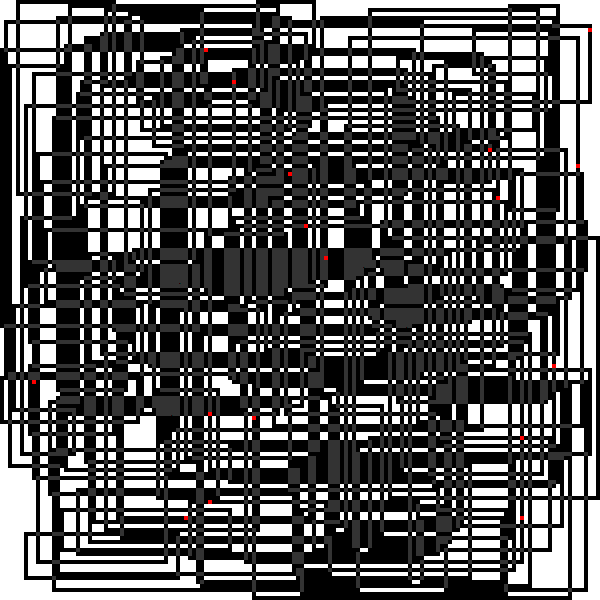

In [2]:
from IPython import display

def render_track(tracks):
    size_x = max([len(l) for l in tracks])
    size_y = len(tracks)
    img = Image.new('RGB', (size_x, size_y), (255, 255, 255))
    draw = ImageDraw.Draw(img)

    for x, y in itertools.product(range(0, size_x), range(0, size_y)):
        if x >= len(tracks[y]):
            continue

        if tracks[y][x] == '+':
            img.putpixel((x, y), (50, 50, 50))
        elif tracks[y][x] != ' ':
            img.putpixel((x, y), (0, 0, 0))
    return img

def render_carts(img, carts):
    for c in carts:
        img.putpixel((c.x, c.y), (255, 0, 0))
    return img

frames = []
img_track = render_track(tracks)

for s in states:
    frame = render_carts(copy.copy(img_track), s)
    frame = frame.resize((size_x * 4, size_y * 4), Image.NEAREST)
    frames.append(frame)
    
imgbytes = io.BytesIO()
frames[0].save(fp = imgbytes, format='GIF', append_images=frames, save_all=True, duration=100, loop=0)
imgbytes.seek(0)
display.Image(imgbytes.read(), format = 'GIF')